# Scientific Computing Exercise Set 1

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

from vibrating_string import *
from diffusion_equation import *
from time_independent_diffusion import *

# Update font 
plt.rcParams.update({'animation.html': "jshtml"})
plt.rcParams.update({'font.size': 14})

## 1.1 Vibrating string

Animation size has reached 20989549 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
Animation size has reached 20986632 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
Animation size has reached 20977092 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


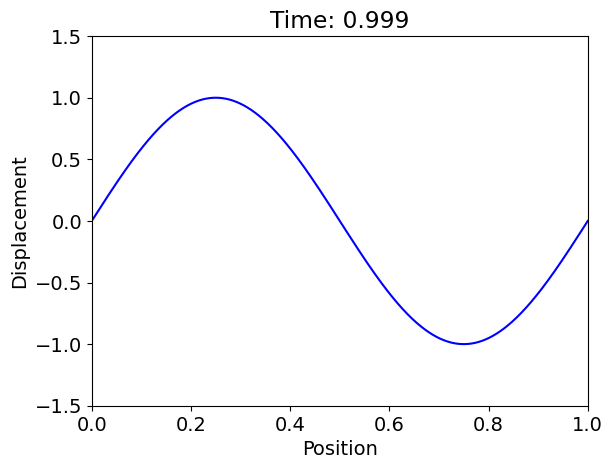

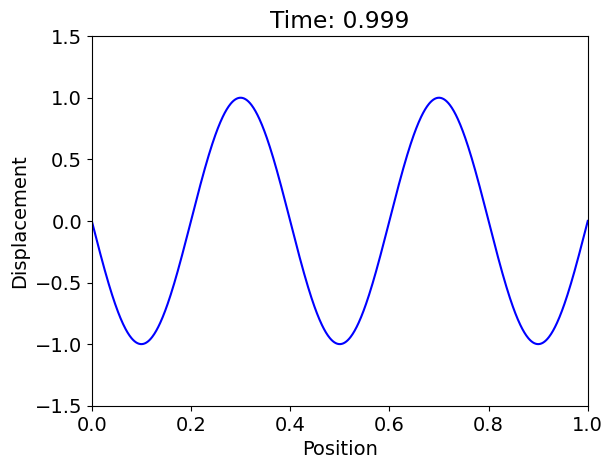

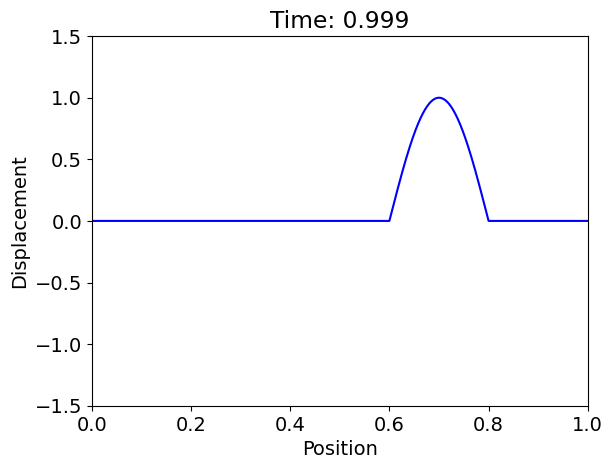

In [2]:
times, solutions = solve_wave_equation(initial_condition= lambda x: np.sin(2*np.pi*x))
fig, update, num_frames = plot_wave_solution(times, solutions)
ani = animation.FuncAnimation(fig, update, frames=num_frames, interval=1, blit=True)
HTML(ani.to_jshtml())

times, solutions = solve_wave_equation(initial_condition= lambda x: np.sin(5*np.pi*x))
fig, update, num_frames = plot_wave_solution(times, solutions)
ani = animation.FuncAnimation(fig, update, frames=num_frames, interval=1, blit=True)
HTML(ani.to_jshtml())

initial_condition = lambda x: np.where((np.array(x) > 1/5) & (np.array(x) < 2/5), np.sin(5*np.pi*x), 0)
times, solutions = solve_wave_equation(initial_condition = initial_condition)
fig, update, num_frames = plot_wave_solution(times, solutions)
ani = animation.FuncAnimation(fig, update, frames=num_frames, interval=1, blit=True)
HTML(ani.to_jshtml())

## 1.2 Time Dependent Diffusion Equation

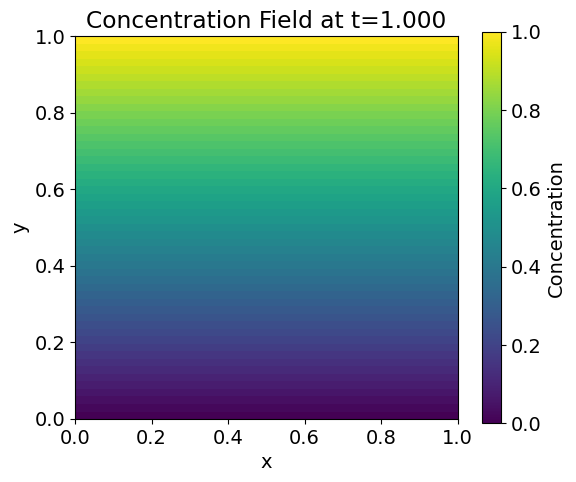

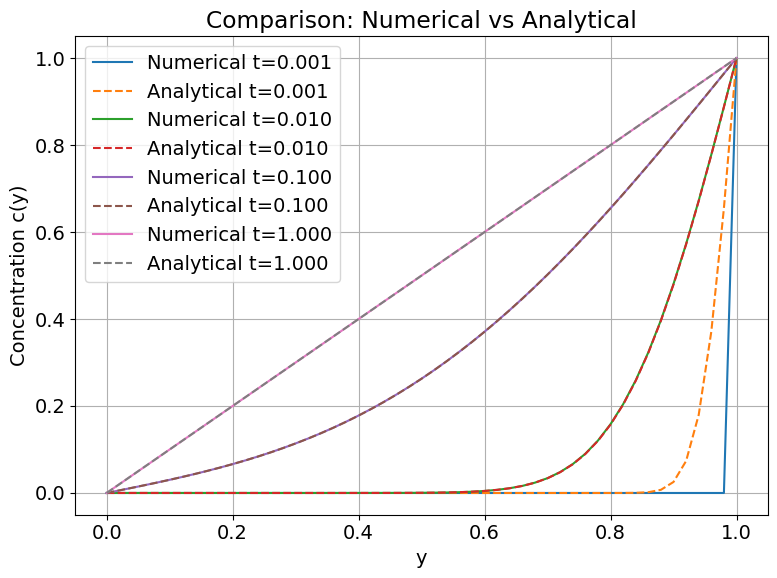

Axes(0.125,0.53;0.352273x0.35)
Axes(0.547727,0.53;0.352273x0.35)
Axes(0.125,0.11;0.352273x0.35)
Axes(0.547727,0.11;0.352273x0.35)


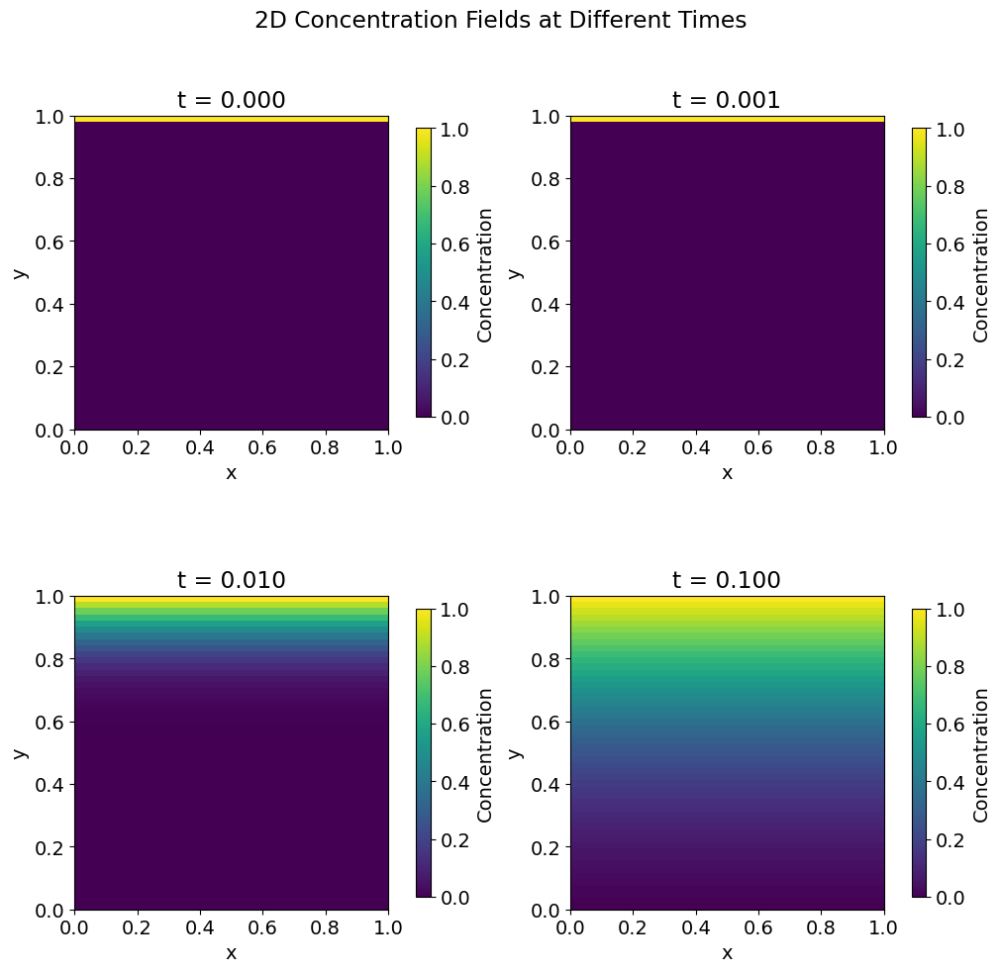

Starting simulation with tolerance=1e-06 and max_iterations=1000000...
Equilibrium reached at t=0.65270 after 6527 iterations with max change 9.99e-07.


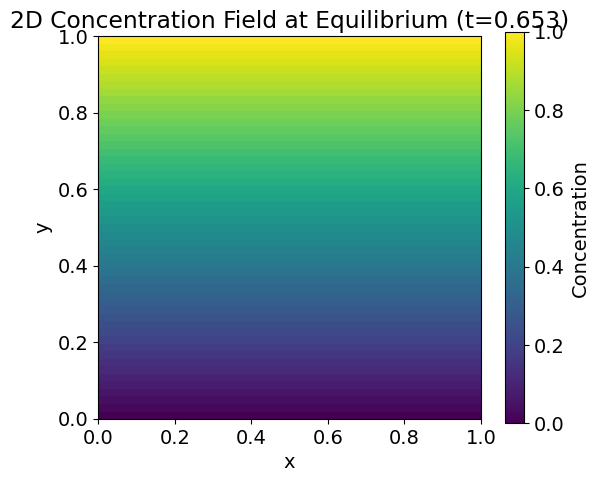

Animation saved as ./Images/diffusion_to_equilibrium_slow.gif.


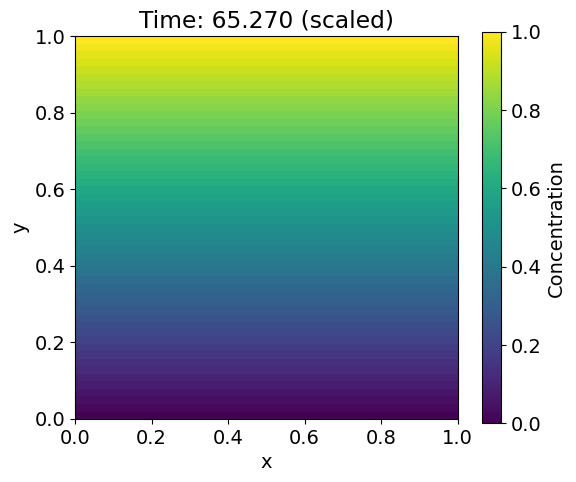

In [3]:
# Run the simulation
times, solutions = diffusion_equation(N=50, T=1.0, dt=0.0001)

# Plot the final 2D concentration field
plot_diffusion(times, solutions)

# Compare numerical and analytical solutions
compare_solution(times, solutions, D=1.0, selected_times=[0.001, 0.01, 0.1, 1.0])

# Plot the results at specified time points
plot_multiple_concentrations(times, solutions, selected_times=[0, 0.001, 0.01, 0.1, 1.0])

# Run the simulation until equilibrium
eq_times, eq_solutions, eq_time = diffusion_equation_until_equilibrium(N=50, dt=0.0001, tolerance=1e-6)

# Plot the final 2D concentration field at equilibrium
plot_diffusion(eq_times, eq_solutions, equilibrium_label=True)

# Create and display a slowed-down animation
animate_diffusion(eq_times, eq_solutions, interval=300, time_multiplier=100, save_animation=True,
                    filename='./Images/diffusion_to_equilibrium_slow.gif')

## 1.3 Time Independent Diffusion Equation

Running comparison...:   0%|          | 0/6 [00:00<?, ?it/s]


Running Jacobi...


Running comparison...:  17%|█▋        | 1/6 [00:01<00:06,  1.25s/it]

Converged after 9769 iterations

Running Gauss-Seidel...


Running comparison...:  33%|███▎      | 2/6 [00:01<00:03,  1.08it/s]

Converged after 5212 iterations

Running SOR (ω=1.70)...


Running comparison...: 100%|██████████| 6/6 [00:02<00:00,  2.23it/s]

Converged after 1053 iterations

Running SOR (ω=1.79)...
Converged after 700 iterations

Running SOR (ω=1.89)...
Converged after 357 iterations

Running SOR (ω=1.98)...
Converged after 936 iterations


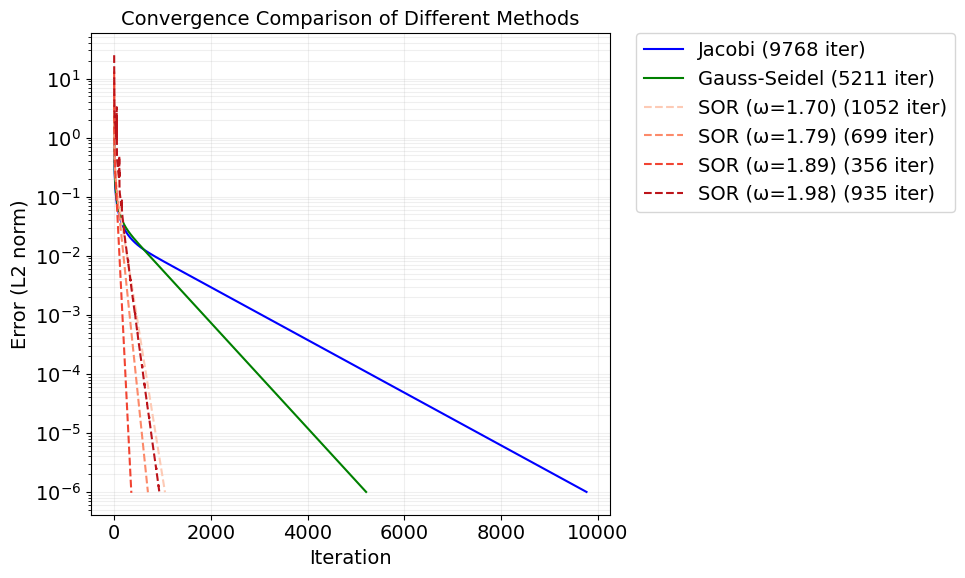

Running comparison...:  17%|█▋        | 1/6 [00:00<00:00,  6.46it/s]


Running Jacobi...
Converged after 3436 iterations

Running Gauss-Seidel...


Running comparison...: 100%|██████████| 6/6 [00:00<00:00, 18.22it/s]


Converged after 1851 iterations

Running SOR (ω=1.70)...
Converged after 373 iterations

Running SOR (ω=1.79)...
Converged after 242 iterations

Running SOR (ω=1.89)...
Converged after 158 iterations

Running SOR (ω=1.98)...
Converged after 882 iterations


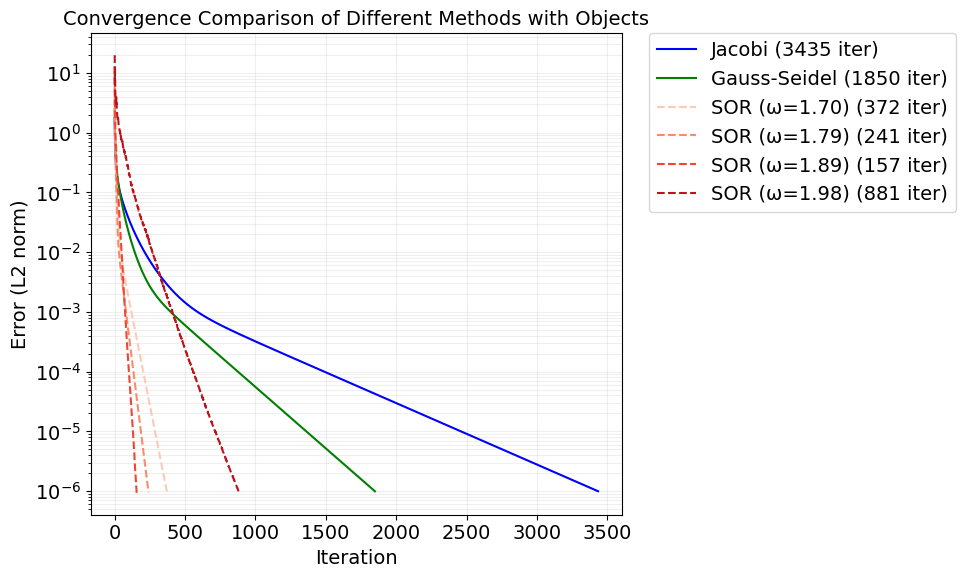

True
True


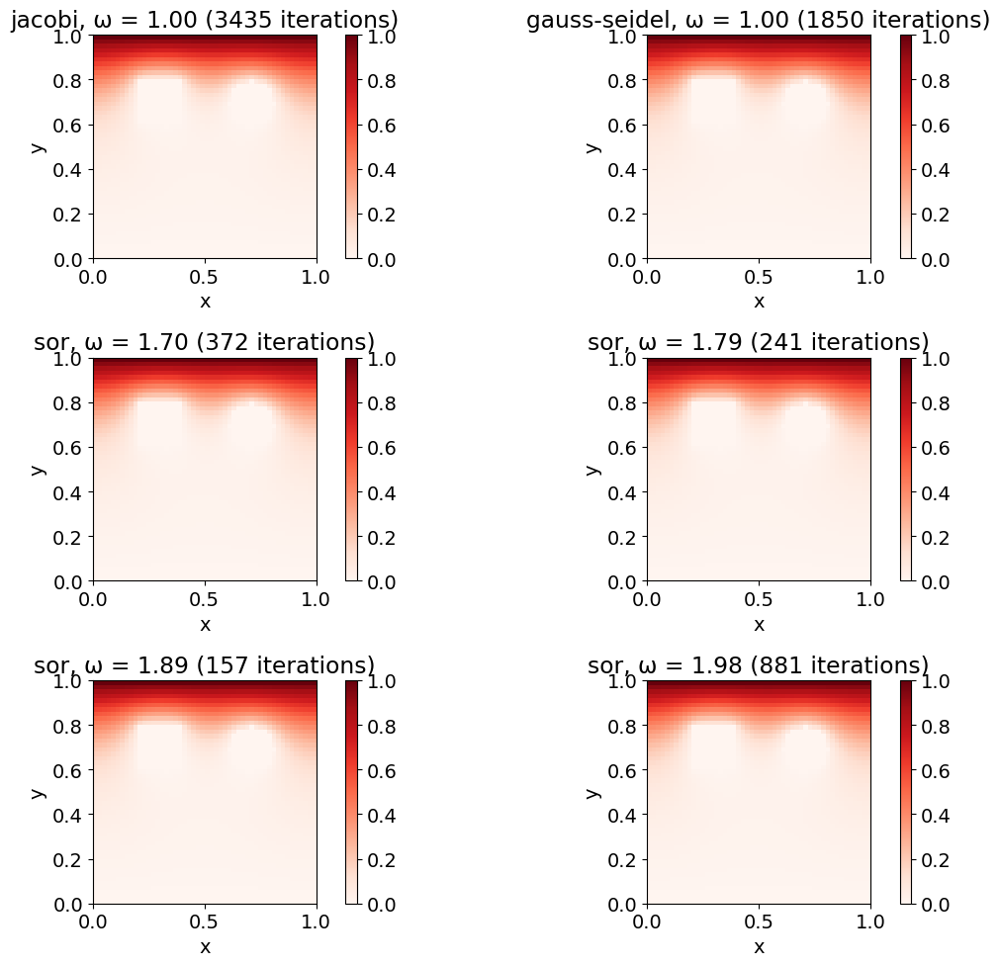

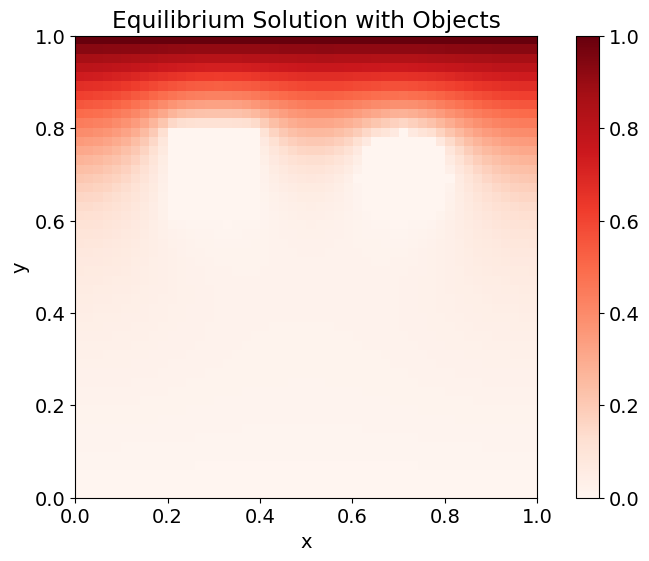

In [4]:
grid_size = (50, 50)
results, fig = solve_diffusion_with_comparison(grid_size=grid_size)
plt.show()

results, fig = solve_diffusion_with_comparison(
    grid_size=grid_size,
    objects_masks=[
            create_rectangle_mask(grid_size, (10, 10), (10, 10)),
            # create_rectangle_mask(grid_size, (1, 20), (40, 40)),
            # create_rectangle_mask(grid_size, (20, 1), (20, 60)),
            create_circle_mask(grid_size, 5, (15, 35)),
            # create_rectangle_mask(grid_size, (20, 20), (65, 15))
            ]
)
plt.show()

print(np.all(np.isclose(results[0]['solution'], results[1]['solution'], atol=1e-4) == True))
print(np.all(np.isclose(results[0]['solution'], results[-1]['solution'], atol=1e-4) == True))
# # Plot final solutions
fig, axes = plt.subplots(3, 2, figsize=(12, 10))
axes = axes.ravel()

methods_to_show = ['Jacobi', 'Gauss-Seidel', 'SOR (ω=1.80)', 'SOR (ω=1.98)']

for i, ax in enumerate(axes):
    result = results[i]
    im = ax.imshow(result['solution'], cmap='Reds', extent=[0, 1, 0, 1])
    ax.set_title(f"{result['method']}, ω = {result['omega']:.2f} ({result['iterations']} iterations)")
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    plt.colorbar(im, ax=ax)

plt.tight_layout()
plt.show()

# Plot a single solution
plt.figure(figsize=(10, 6))
plt.imshow(results[-1]['solution'], cmap='Reds', extent=[0, 1, 0, 1])
plt.xlabel('x')
plt.ylabel('y')
plt.colorbar()
plt.title('Equilibrium Solution with Objects')
plt.savefig('./Images/final_solution_objects.pdf')
plt.show()

Finding optimal omega...:   5%|▌         | 1/20 [00:00<00:02,  6.73it/s]


Testing grid size N=10
N=10: Best omega=1.6300 with 38 iterations

Testing grid size N=11


Finding optimal omega...:  15%|█▌        | 3/20 [00:00<00:02,  6.12it/s]

N=11: Best omega=1.6600 with 43 iterations

Testing grid size N=12
N=12: Best omega=1.6800 with 48 iterations

Testing grid size N=14


Finding optimal omega...:  20%|██        | 4/20 [00:00<00:03,  5.27it/s]

N=14: Best omega=1.7300 with 57 iterations

Testing grid size N=16


Finding optimal omega...:  25%|██▌       | 5/20 [00:00<00:03,  4.82it/s]

N=16: Best omega=1.7600 with 66 iterations

Testing grid size N=18


Finding optimal omega...:  30%|███       | 6/20 [00:01<00:03,  4.56it/s]

N=18: Best omega=1.7900 with 76 iterations

Testing grid size N=20


Finding optimal omega...:  35%|███▌      | 7/20 [00:01<00:03,  4.07it/s]

N=20: Best omega=1.8100 with 86 iterations

Testing grid size N=23


Finding optimal omega...:  40%|████      | 8/20 [00:01<00:03,  3.52it/s]

N=23: Best omega=1.8300 with 99 iterations

Testing grid size N=26


Finding optimal omega...:  45%|████▌     | 9/20 [00:02<00:03,  3.09it/s]

N=26: Best omega=1.8500 with 113 iterations

Testing grid size N=29


Finding optimal omega...:  50%|█████     | 10/20 [00:02<00:03,  2.51it/s]

N=29: Best omega=1.8600 with 131 iterations

Testing grid size N=33


Finding optimal omega...:  55%|█████▌    | 11/20 [00:03<00:04,  2.06it/s]

N=33: Best omega=1.8800 with 146 iterations

Testing grid size N=37


Finding optimal omega...:  60%|██████    | 12/20 [00:04<00:04,  1.65it/s]

N=37: Best omega=1.8900 with 168 iterations

Testing grid size N=42


Finding optimal omega...:  65%|██████▌   | 13/20 [00:05<00:05,  1.24it/s]

N=42: Best omega=1.9100 with 196 iterations

Testing grid size N=48


Finding optimal omega...:  70%|███████   | 14/20 [00:07<00:06,  1.13s/it]

N=48: Best omega=1.9200 with 222 iterations

Testing grid size N=54


Finding optimal omega...:  75%|███████▌  | 15/20 [00:10<00:07,  1.54s/it]

N=54: Best omega=1.9300 with 255 iterations

Testing grid size N=61


Finding optimal omega...:  80%|████████  | 16/20 [00:13<00:08,  2.12s/it]

N=61: Best omega=1.9300 with 299 iterations

Testing grid size N=69


Finding optimal omega...:  85%|████████▌ | 17/20 [00:18<00:08,  2.97s/it]

N=69: Best omega=1.9400 with 324 iterations

Testing grid size N=78


Finding optimal omega...:  90%|█████████ | 18/20 [00:25<00:08,  4.28s/it]

N=78: Best omega=1.9500 with 364 iterations

Testing grid size N=88


Finding optimal omega...:  95%|█████████▌| 19/20 [00:36<00:06,  6.30s/it]

N=88: Best omega=1.9500 with 451 iterations

Testing grid size N=100


Finding optimal omega...: 100%|██████████| 20/20 [00:53<00:00,  2.69s/it]

N=100: Best omega=1.9600 with 463 iterations


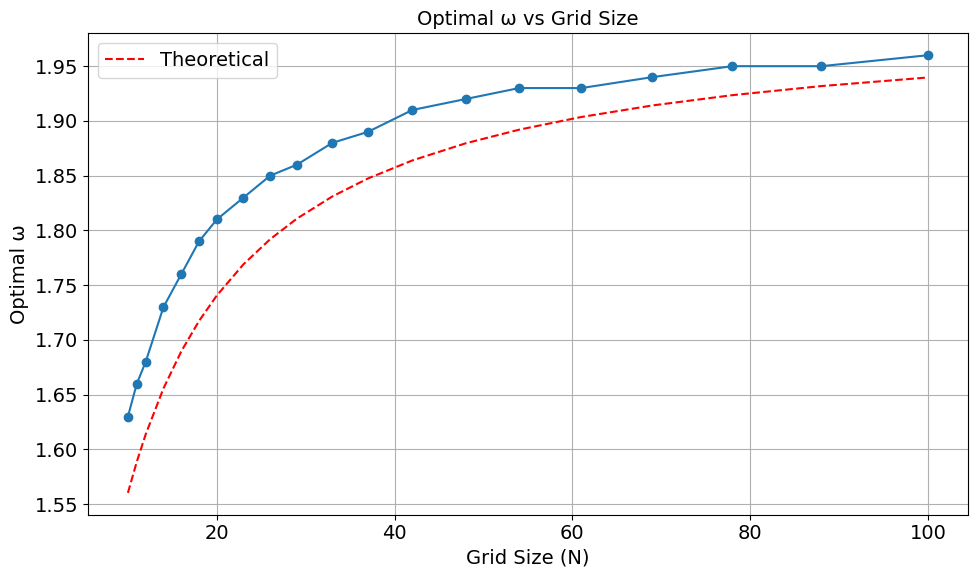


Final Results:
N	Optimal ω	Iterations
----------------------------------------
10	1.6300	38
11	1.6600	43
12	1.6800	48
14	1.7300	57
16	1.7600	66
18	1.7900	76
20	1.8100	86
23	1.8300	99
26	1.8500	113
29	1.8600	131
33	1.8800	146
37	1.8900	168
42	1.9100	196
48	1.9200	222
54	1.9300	255
61	1.9300	299
69	1.9400	324
78	1.9500	364
88	1.9500	451
100	1.9600	463


Finding optimal omega...:   0%|          | 0/1 [00:00<?, ?it/s]


Testing grid size N=50


Finding optimal omega...: 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]

N=50: Best omega=1.8700 with 138 iterations


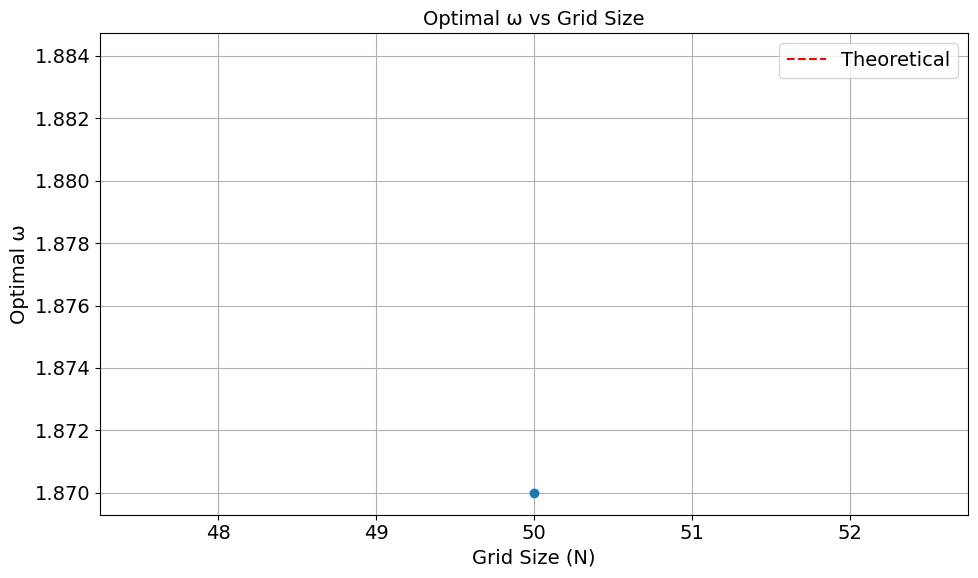


Final Results:
N	Optimal ω	Iterations
----------------------------------------
50	1.8700	138


In [5]:
grid_size = (50, 50)

# Optimal omega with free grid
resuts, fig = find_optimal_omega()
plt.show()

# Optimal omega with objects
resuts, fig = find_optimal_omega(
    N_values=[50],
    objects_masks=[
            create_rectangle_mask(grid_size, (10, 10), (10, 10)),
            create_circle_mask(grid_size, 5, (15, 35)),
        ]
)